# Drift Synthesis by Adversarial Attack based on Statistical Face Model with FaceNet

* Let us select a stream of faces where drift is synthesised using inference performed on FaceNet

* Let us use a classifier model on FaceNet embeddings for detecting the drift

## Classifier Model to detect the Drift

In [1]:
from sklearn.ensemble import HistGradientBoostingClassifier
import numpy as np
import pandas as pd
from scipy.spatial import distance
from sklearn.model_selection import train_test_split
import pickle
import scipy.io
import seaborn as sns
import tensorflow as tf
from keras.models import load_model, Model
import skimage.transform
from tqdm import tqdm
import scipy.io
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import MDS
from sklearn.neighbors import KNeighborsClassifier
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.manifold import SpectralEmbedding
from sklearn.cluster import DBSCAN, OPTICS
from sklearn.svm import SVC, LinearSVC
import os, sys

DATADIR = '../metadata'
MODELDIR = './facenet/models/20180408-102900/20180408-102900'

ModuleNotFoundError: No module named 'scipy.fft'

### Inference output from FaceNet

* stream_sample: metadata extract of CACD2000
* images: All the Images collected for PCA Analysis

In [2]:
images = pickle.load(open("drift_synthesis_images2.pkl", "rb"))

In [320]:
images_dict = pickle.load(open("drift_synthesis_images2_dict.pkl", "rb"))

In [3]:
mat = scipy.io.loadmat(DATADIR + "/Metadata_Datasets/celebrity2000_meta.mat")
age, identity, year, feature_1, feature_2, feature_3, feature_4, name = mat['celebrityImageData'][0][0]
metadata_CACD = pd.DataFrame(np.vstack([age.flatten(), identity.flatten(), year.flatten(), 
                            np.array(list(map(lambda x: x.tolist()[0][0].split("_")[1] + "_" + x.tolist()[0][0].split("_")[2], name))), 
                            np.array(list(map(lambda x: x.tolist()[0][0], name)))]).T, 
                  columns=['age', 'identity', 'year', 'name', 'filename'])

metadata_CACD['age'] = metadata_CACD['age'].astype(int)
metadata_CACD['identity'] = metadata_CACD['identity'].astype(int)
metadata_CACD['year'] = metadata_CACD['year'].astype(int)

reduced_metadata_CACD = metadata_CACD.groupby(['identity', 'age']).count()
reduced_metadata_CACD['year_select'] = reduced_metadata_CACD['year'] / 9
reduced_metadata_CACD = reduced_metadata_CACD.loc[reduced_metadata_CACD['year_select'] >= 1].loc[(reduced_metadata_CACD.loc[reduced_metadata_CACD['year_select'] >= 1].index.get_level_values(0) != 1852) & \
                                         (reduced_metadata_CACD.loc[reduced_metadata_CACD['year_select'] >= 1].index.get_level_values(0) != 1768) & \
                                        (reduced_metadata_CACD.loc[reduced_metadata_CACD['year_select'] >= 1].index.get_level_values(0) != 1415) & \
                                        (reduced_metadata_CACD.loc[reduced_metadata_CACD['year_select'] >= 1].index.get_level_values(0) != 1360)]
reduced_metadata_CACD['age'] = reduced_metadata_CACD.index.get_level_values(1)
reduced_metadata_CACD['identity'] = reduced_metadata_CACD.index.get_level_values(0)
stream_sample = reduced_metadata_CACD.copy()
stream_sample

year  name  filename  year_select  age  identity
identity age                                                  
1        53     11    11        11     1.222222   53         1
         58     11    11        11     1.222222   58         1
         61     11    11        11     1.222222   61         1
         62     11    11        11     1.222222   62         1
2        54     12    12        12     1.333333   54         2
...            ...   ...       ...          ...  ...       ...
1999     15     10    10        10     1.111111   15      1999
         16     11    11        11     1.222222   16      1999
         21     10    10        10     1.111111   21      1999
2000     22     12    12        12     1.333333   22      2000
         23     12    12        12     1.333333   23      2000

[9216 rows x 6 columns]

In [4]:
print(images.shape)

(9216, 96, 96, 3)


In [5]:
images[0].min(), images[0].max()

(0.0, 0.9836343807929211)

In [322]:
from collections import OrderedDict

images_dict = OrderedDict(images_dict)

In [324]:
images_dict.keys()

odict_keys(['53_Robin_Williams_0002.jpg', '58_Robin_Williams_0014.jpg', '61_Robin_Williams_0008.jpg', '62_Robin_Williams_0004.jpg', '54_Mark_Hamill_0016.jpg', '55_Mark_Hamill_0016.jpg', '60_Mark_Hamill_0003.jpg', '61_Mark_Hamill_0007.jpg', '62_Mark_Hamill_0007.jpg', '54_Kurt_Russell_0009.jpg', '59_Kurt_Russell_0009.jpg', '60_Kurt_Russell_0010.jpg', '61_Kurt_Russell_0010.jpg', '57_Stellan_Skarsgård_0014.jpg', '62_Stellan_Skarsgård_0007.jpg', '54_Anjelica_Huston_0014.jpg', '60_Anjelica_Huston_0006.jpg', '61_Anjelica_Huston_0009.jpg', '62_Anjelica_Huston_0011.jpg', '55_Geoffrey_Rush_0015.jpg', '56_Geoffrey_Rush_0002.jpg', '59_Geoffrey_Rush_0011.jpg', '60_Geoffrey_Rush_0001.jpg', '61_Geoffrey_Rush_0006.jpg', '62_Geoffrey_Rush_0006.jpg', '53_Michael_Keaton_0011.jpg', '56_Michael_Keaton_0009.jpg', '57_Michael_Keaton_0007.jpg', '60_Michael_Keaton_0010.jpg', '61_Michael_Keaton_0007.jpg', '62_Michael_Keaton_0007.jpg', '54_Kirstie_Alley_0004.jpg', '56_Kirstie_Alley_0003.jpg', '57_Kirstie_Alley_0

## Load the FaceNet Keras Model

### deprecated

In [6]:
model = load_model('../metadata/facenet_keras.h5')
facenet_model = Model(inputs=model.input, outputs=model.layers[-1].output)

In [27]:
!git clone https://github.com/davidsandberg/facenet

Cloning into 'facenet'...
Updating files:  86% (84/97)
Updating files:  87% (85/97)
Updating files:  88% (86/97)
Updating files:  89% (87/97)
Updating files:  90% (88/97)
Updating files:  91% (89/97)
Updating files:  92% (90/97)
Updating files:  93% (91/97)
Updating files:  94% (92/97)
Updating files:  95% (93/97)
Updating files:  96% (94/97)
Updating files:  97% (95/97)
Updating files:  98% (96/97)
Updating files: 100% (97/97)
Updating files: 100% (97/97), done.


## Loading the Facenet TensorFlow Model

In [7]:
from facenet.src import facenet
from facenet.src import classifier

In [11]:
with tf.Graph().as_default():
    with tf.compat.v1.Session() as sess:
        facenet_tf_model = facenet.load_model(os.path.join(MODELDIR, '20180408-102900.pb'))

Model filename: ./facenet/models/20180408-102900/20180408-102900\20180408-102900.pb


## Preprocessing for FaceNet Images

**Reference**

https://github.com/nyoki-mtl/keras-facenet/blob/master/notebook/demo-images.ipynb

In [7]:
def prewhiten(x):
    if x.ndim == 4:
        axis = (1, 2, 3)
        size = x[0].size
    elif x.ndim == 3:
        axis = (0, 1, 2)
        size = x.size
    else:
        raise ValueError('Dimension should be 3 or 4')

    mean = np.mean(x, axis=axis, keepdims=True)
    std = np.std(x, axis=axis, keepdims=True)
    std_adj = np.maximum(std, 1.0/np.sqrt(size))
    y = (x - mean) / std_adj
    return y

def l2_normalize(x, axis=-1, epsilon=1e-10):
    output = x / np.sqrt(np.maximum(np.sum(np.square(x), axis=axis, keepdims=True), epsilon))
    return output

### Collect Inference output from Keras FaceNet Model

In [62]:
inference_images = []
res_images = []
image_size = 160
# Get input and output tensors
for ii, image in tqdm(enumerate(images)):
    image = skimage.transform.resize(image, (image_size,image_size))
    image = skimage.color.rgb2gray(image)
    image = np.concatenate([np.expand_dims(image, 2)]*3, 2)
    inference_images.append(image)
    if (ii+1) % 128 == 0:
        res_images.append(facenet_model(l2_normalize(prewhiten(np.stack(inference_images))).reshape(-1,160,160,3)))
        inference_images = []

9216it [07:09, 21.46it/s]


In [61]:
pickle.dump(inference_images, open("drift_synthesis_color_inference_images.pkl", "wb"))

In [ ]:
inference_images = []
nrof_images = 9216

emb_array = None
images_placeholder = None
embeddings = None
phase_train_placeholder = None

image_size = None
embedding_size = None
batch_size = 128

with tf.Graph().as_default():
    facenet_tf_model = facenet.load_model(os.path.join(MODELDIR, '20180408-102900.pb'))
    with tf.compat.v1.Session() as sess:
        # Get input and output tensors
        images_placeholder = tf.get_default_graph().get_tensor_by_name("input:0")
        embeddings = tf.get_default_graph().get_tensor_by_name("embeddings:0")
        phase_train_placeholder = tf.get_default_graph().get_tensor_by_name("phase_train:0")
        
        image_size = 220
        embedding_size = embeddings.get_shape()[1]
        
        emb_array = np.zeros((nrof_images, embedding_size))
        
        for ii, image in tqdm(enumerate(images)):
            image = skimage.transform.resize(image, (image_size,image_size))
            inference_images.append(image)
            if (ii+1) % batch_size == 0:
                feed_dict = { images_placeholder:np.stack(inference_images), phase_train_placeholder:False}
                emb_array[ii-127:ii+1,:] = sess.run(embeddings, feed_dict=feed_dict)
                inference_images = []

In [63]:
result_stream_embeddings = tf.concat(res_images, axis=0)

In [64]:
result_stream_embeddings.shape

TensorShape([9216, 128])

## Calculating the Euclidean Distance

* Let us take the first few thousand images for analysis

In [36]:
image_length = 2000
norm = np.zeros((image_length, image_length))

for i in tqdm(range(image_length)):
    for j in range(i+1, image_length):
        norm[i,j] = distance.euclidean(result_stream_embeddings[i], result_stream_embeddings[j])

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [13:08<00:00,  2.54it/s]


In [37]:
norm_copy = norm.copy()
norm_copy += norm_copy.T
norm_copy.shape

(2000, 2000)

## Calculating the Cosine Similarity

In [38]:
matrix_product = tf.matmul(result_stream_embeddings, tf.transpose(result_stream_embeddings))

cosine = np.zeros((image_length, image_length))

for i in tqdm(range(image_length)):
    for j in range(i+1, image_length):
        cosine[i,j] = matrix_product[i,j] / (tf.norm(result_stream_embeddings[i], ord=2) * \
        tf.norm(result_stream_embeddings[j], ord=2))

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████| 2000/2000 [33:31<00:00,  1.01s/it]


In [39]:
cosine_copy = cosine.copy()
cosine_copy += cosine_copy.T
cosine_copy.shape

(2000, 2000)

## Visualizing the Heatmap of Cosine Similarity and Euclidean Distance

<AxesSubplot:>

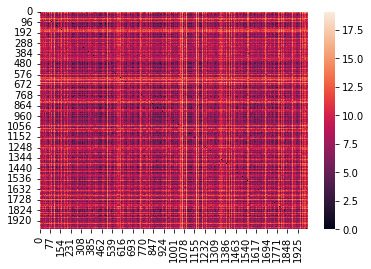

In [40]:
sns.heatmap(norm_copy)

<AxesSubplot:>

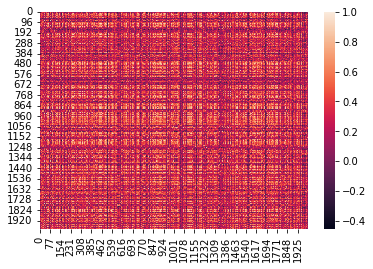

In [41]:
sns.heatmap(cosine_copy)

## Multi-Dimensional Scaling

(array([  3.,  43., 183., 384., 408., 189.,  60.,   8.,   1.,   1.]),
 array([-1.9888054 , -1.4948509 , -1.0008965 , -0.506942  , -0.01298749,
         0.480967  ,  0.97492146,  1.4688759 ,  1.9628304 ,  2.456785  ,
         2.9507394 ], dtype=float32),
 <BarContainer object of 10 artists>)

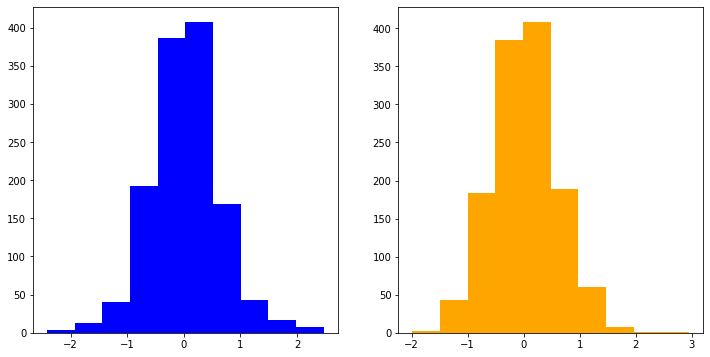

In [52]:
fig = plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
plt.hist(result_stream_embeddings.numpy()[:10].flatten(), color='blue')
plt.subplot(1,2,2)
plt.hist(result_stream_embeddings.numpy()[10:20].flatten(), color='orange')

In [121]:
X = result_stream_embeddings.numpy()
y = pd.get_dummies(stream_sample['identity']).values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

mds = MDS(n_components=2, dissimilarity='precomputed')
mds.fit(norm_copy)

MDS(dissimilarity='precomputed')

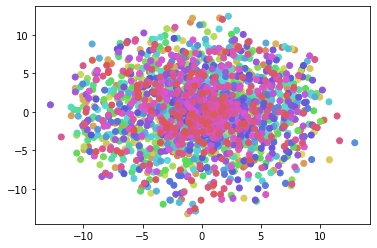

In [79]:
colors = sns.color_palette("hls", 2000)
plt.scatter(mds.embedding_[:, 0], mds.embedding_[:, 1], c=colors)

In [80]:
X = result_stream_embeddings.numpy()
y = stream_sample['identity']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

mds = MDS(n_components=128, dissimilarity='precomputed')
mds.fit(norm_copy)

MDS(dissimilarity='precomputed', n_components=128)

## Classifier

In [87]:
kneighbors = KNeighborsClassifier(n_neighbors=100)

X_train, X_test, y_train, y_test = train_test_split(mds.embedding_, y.iloc[:image_length], test_size=0.2, random_state=42)

kneighbors.fit(X_train, y_train)
kneighbors.score(X_test, y_test)

0.015

## PCA

In [101]:
pca = PCA(n_components=30)
X_pca = pca.fit_transform(StandardScaler().fit_transform(result_stream_embeddings.numpy()))
pca.explained_variance_ratio_.sum()

0.83913565

## Spectral Embedding

In [106]:
spectral = SpectralEmbedding(n_components=3)
spectral.fit(StandardScaler().fit_transform(result_stream_embeddings.numpy()))

SpectralEmbedding(n_components=3)

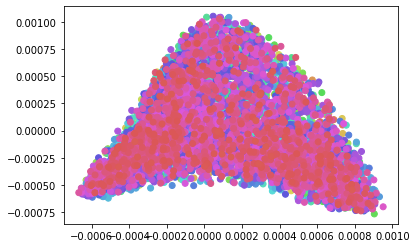

In [111]:
colors = sns.color_palette("hls", 2001)
colors = np.array(colors)
colors = colors[y.values.tolist()]
plt.scatter(spectral.embedding_[:, 0], spectral.embedding_[:, 1], c=colors)

## Plot of Images from the Database

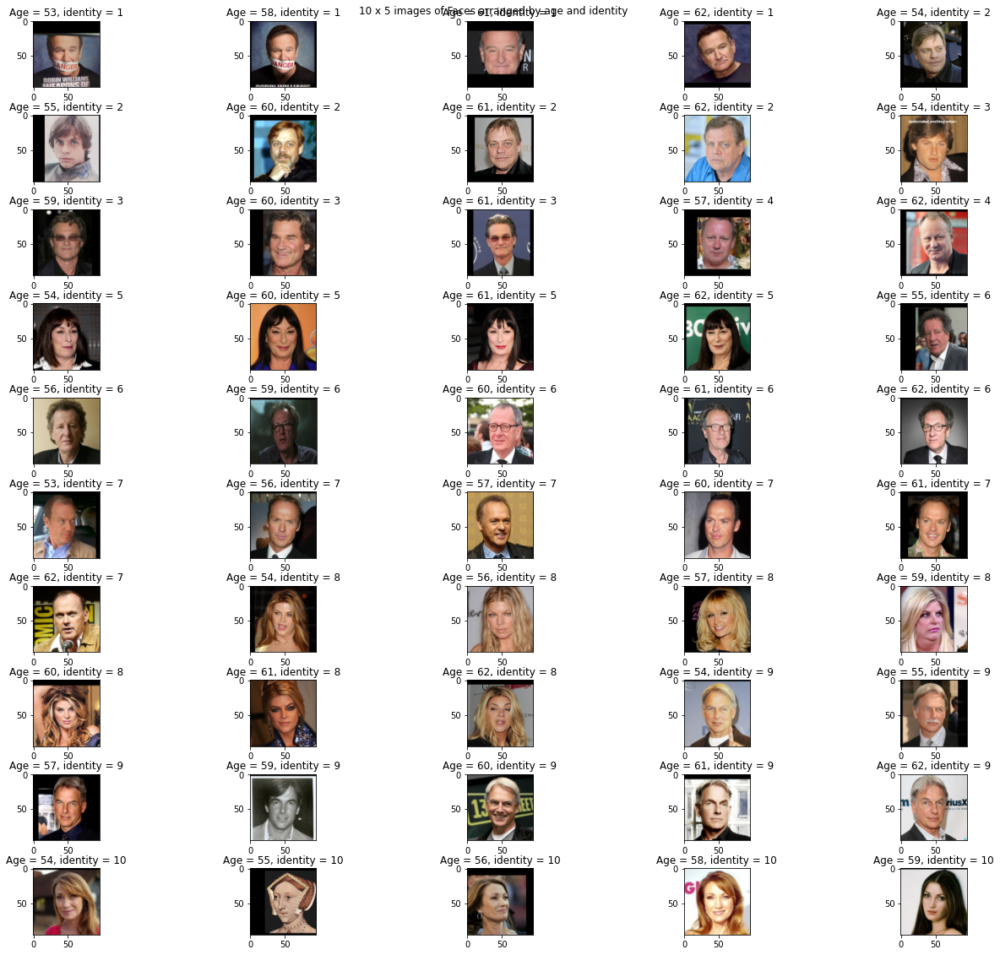

In [20]:
fig, ax = plt.subplots(10,5,figsize=(18,16))

fig.suptitle("10 x 5 images of Faces arranged by age and identity")

fig.tight_layout(pad=1.2)

for i in range(10):
    for j in range(5):
        ax[i,j].imshow(images[i*5+j])
        data = stream_sample.loc[:, ['age', 'identity']].iloc[i*5+j]
        ax[i,j].set_title("Age = " + data['age'].astype(str) + ", identity = " + data['identity'].astype(str))

## SVM Classifier

**Reference**

https://github.com/davidsandberg/facenet/blob/master/src/classifier.py

**Performs 5-fold CV within the SVM Algorithm**

In [12]:
svm = SVC(kernel='linear', probability=True)

X = result_stream_embeddings.numpy()
y = stream_sample['identity']

svm.fit(X, y)

predictions = svm.predict_proba(X)
best_class_indices = np.argmax(predictions, axis=1)
best_class_probabilities = predictions[np.arange(len(best_class_indices)), best_class_indices]

In [26]:
best_class_probabilities

array([0.00186866, 0.00211102, 0.00180775, ..., 0.00225055, 0.00199867,
       0.00327832])

### Class Output of Linear SVM Kernel with Probability / Predict_Proba

In [13]:
best_class_indices

array([ 924,  481, 1169, ...,  408, 1710, 1245], dtype=int64)

In [15]:
from sklearn.metrics import accuracy_score

accuracy_score(y.values, best_class_indices)

0.0006510416666666666

### SVM Kernel formed from MatMul gram matrix

In [170]:
from sklearn.svm import SVC, LinearSVC

def my_kernel(X, Y):
    return X.dot(Y.T)

X = result_stream_embeddings.numpy()
y = stream_sample['identity']

svm_kernel = SVC(kernel=my_kernel)
svm_kernel.fit(X, y)

SVC(kernel=<function my_kernel at 0x0000012588561318>)

In [171]:
y_pred = svm_kernel.predict(X)

## Loading the SVM Kernel into Notebook

In [157]:
def my_kernel(X, Y):
    return X.dot(Y.T)

svm_kernel = pickle.load(open("drift_synthesis_eda_svm_kernel.pkl", "rb"))

## Accuracy Score obtained for the SVM Classifier

In [172]:
from sklearn.metrics import accuracy_score

accuracy_score(y, y_pred)

0.8305121527777778

### Saving SVM Custom Kernel Model

In [174]:
pickle.dump(svm_kernel, open("drift_synthesis_eda_svm_kernel.pkl", "wb"))

## PCA based Analysis on Faces to create a Statistical Model

In [14]:
stream_sample.head()

year  name  filename  year_select  age  identity
identity age                                                  
1        53     11    11        11     1.222222   53         1
         58     11    11        11     1.222222   58         1
         61     11    11        11     1.222222   61         1
         62     11    11        11     1.222222   62         1
2        54     12    12        12     1.333333   54         2

### Convert images to black and white images

In [69]:
images_bw = images.copy()

for ii, image in enumerate(images_bw):
    image = skimage.color.rgb2gray(images_bw[ii])
    images_bw[ii,:,:,:1] = image.reshape(96,96,1)
    images_bw[ii,:,:,1:2] = image.reshape(96,96,1)
    images_bw[ii,:,:,2:] = image.reshape(96,96,1)
    
images_bw = np.mean(images_bw, axis=3)
images_color = images.copy()

## Plot of Images in Black and White Mode

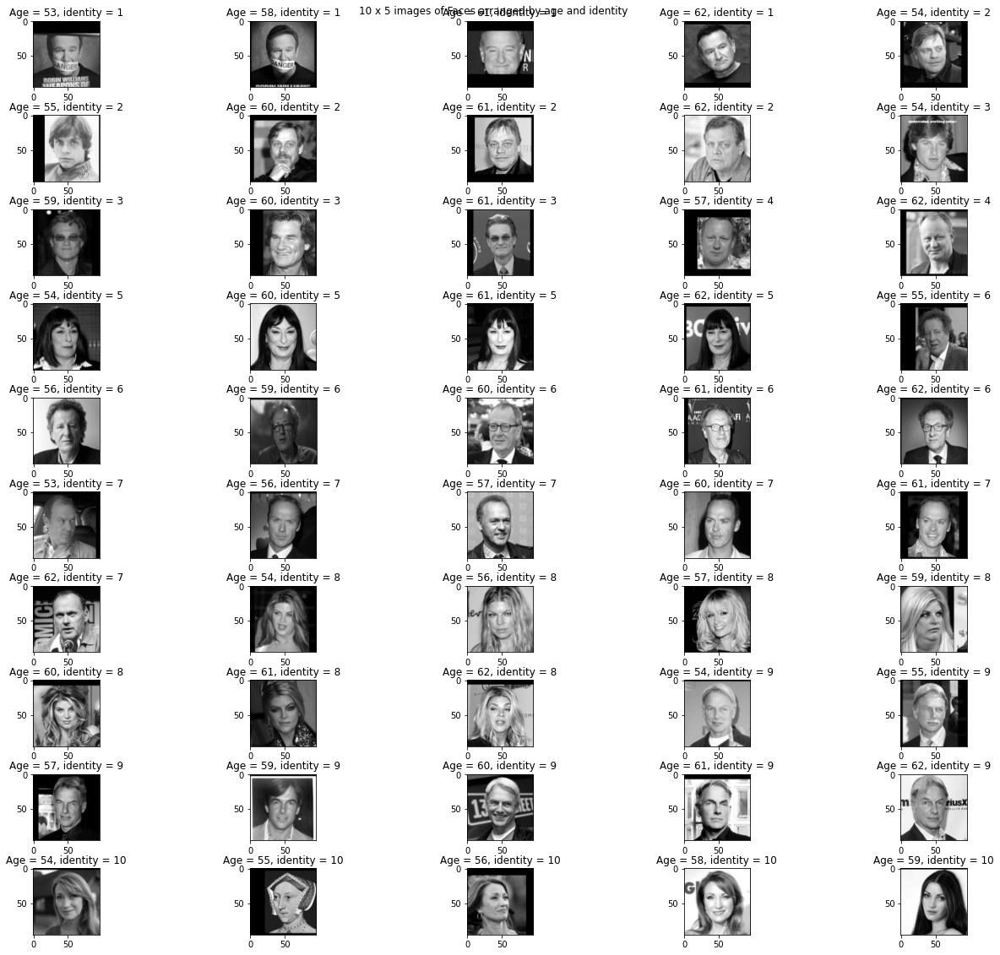

In [24]:
fig, ax = plt.subplots(10,5,figsize=(18,16))

fig.suptitle("10 x 5 images of Faces arranged by age and identity")

fig.tight_layout(pad=1.2)

for i in range(10):
    for j in range(5):
        ax[i,j].imshow(images_bw[i*5+j], cmap='gray')
        data = stream_sample.loc[:, ['age', 'identity']].iloc[i*5+j]
        ax[i,j].set_title("Age = " + data['age'].astype(str) + ", identity = " + data['identity'].astype(str))

#### Calculating the mean of Images and demeaning the images

In [70]:
images_mean = np.mean(images_bw.reshape(9216,-1), axis=1)
images_new = (images_bw.reshape(9216,-1) - images_mean.reshape(9216, 1)).reshape(9216,96,96)

### Calculating the Covariance of the Images

In [71]:
images_cov = np.cov(images_new.reshape(9216,-1))
images_cov.shape

(9216, 9216)

#### Fitting the Covariance with PCA

In [72]:
from sklearn.decomposition import PCA

pca = PCA(n_components=9216)
pca.fit(images_cov)
P = pca.components_.T
P.shape

(9216, 9216)

#### Evaluating the Mahalanobis Vector to calculate the distance between images

### b = P^-1 * (X − Xm)

In [19]:
b = np.matmul(np.linalg.inv(P), images_new.reshape(9216,-1))
b.shape

(9216, 9216)

### Evaluating the Weights vector for the Mahalanobis Vector

### age = offset + w1 * b^T

In [20]:
w = (stream_sample['age'] - 11).dot(np.linalg.inv(b))
w

array([ 2.07406274e+03, -2.37482628e+03,  6.39860997e+01, ...,
       -1.17114376e+18, -1.37015296e+18, -8.64595357e+17])

### Evaluating the Weights vector for the Square of Mahalanobis Vector

In [181]:
w2 = (stream_sample['age'] - 11 - w.T.dot(b)).dot(np.linalg.inv(b**2))
w2

array([ 2.36020980e-06, -1.85166938e-07, -2.34146979e-07, ...,
       -9.62647669e+22, -5.81360406e+22,  8.32617492e+22])

### Evaluating the Weights vector for the Cube of Mahalanobis vector

In [182]:
w3 = (stream_sample['age'] - 11 - w.T.dot(b) - w2.T.dot(b**2)).dot(np.linalg.inv(b**3))
w3

array([-1.12433496e-18,  2.93630949e-18, -3.69297010e-18, ...,
        4.64731687e+26,  2.25449573e+26,  4.28866102e+26])

## The Age Function

In [21]:
w.T.dot(b) + 11 - stream_sample['age']

identity  age
1         53    -1.064501e-05
          58     5.246201e-06
          61     2.576329e-06
          62    -6.157788e-07
2         54    -7.800409e-07
                     ...     
1999      15     9.062238e-06
          16    -2.006372e-05
          21    -4.311026e-05
2000      22    -1.815535e-05
          23     3.995519e-05
Name: age, Length: 9216, dtype: float64

In [33]:
w.T.dot(b) + w2.T.dot(b**2) + w3.T.dot(b**3) + 11 - stream_sample['age']

identity  age
1         53     0.0
          58     0.0
          61     0.0
          62     0.0
2         54     0.0
                ... 
1999      15     0.0
          16     0.0
          21     0.0
2000      22     0.0
          23     0.0
Name: age, Length: 9216, dtype: float64

## The Similarities of Faces

* There are two distances: Identity Grouping Distance and Age Wise Distances

* Identity grouping Distance: Is calculated using Mahalanobis Distance
* Age Wise Distances: Is calculated using weights vector, the distance between weights will be the age wise distance

In [22]:
# mahalanobis distance

from tqdm import tqdm

newstream_sample = stream_sample.copy()

def mahalanobis(bn, bm, C):
    if len(C.shape) == 0:
        return ((bn - bm)).dot((bn - bm).T) * C
    else:
        return (((bn - bm).T).dot(np.linalg.inv(C))).T.dot((bn - bm).T)

newstream_sample['identity_grouping_distance'] = 0.0

distances = []
for subject in tqdm(np.unique(newstream_sample['identity'])):
    b_vector = b[newstream_sample['identity'] == subject]
    bm = np.expand_dims(b_vector.mean(axis=1), 1)
    C = np.cov(b_vector)
    distance = mahalanobis(b_vector, bm, C)
    newstream_sample.loc[newstream_sample['identity'] == subject, 'identity_grouping_distance'] = np.diag(distance)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1934/1934 [00:03<00:00, 492.70it/s]


## Deciding a Cutoff range

In [350]:
cutoff_range = np.unique(np.round(np.unique(newstream_sample['identity_grouping_distance']), 1))
cutoff_range

array([0.0000e+00, 1.0000e-01, 2.0000e-01, 3.0000e-01, 4.0000e-01,
       5.0000e-01, 8.0000e-01, 1.0000e+00, 1.1000e+00, 1.4000e+00,
       1.6000e+00, 1.7000e+00, 5.7000e+00, 6.5000e+00, 6.6000e+00,
       7.3000e+00, 7.4000e+00, 8.0000e+00, 8.4000e+00, 2.2700e+01,
       2.7500e+01, 2.8800e+01, 3.0700e+01, 3.1400e+01, 3.1500e+01,
       3.3800e+01, 4.8600e+01, 6.2900e+01, 6.3100e+01, 6.5500e+01,
       1.1900e+02, 1.6330e+02, 1.6350e+02, 5.0400e+02, 6.8560e+02,
       1.1769e+03, 1.5201e+03, 2.8173e+03, 4.1419e+03, 7.8328e+03,
       9.2150e+03])

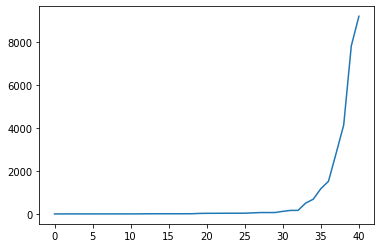

In [351]:
plt.plot(np.arange(0,len(cutoff_range)), cutoff_range)

### Automating the cutoff range based on face distance similarities and equalised number of subjects

In [352]:
sample_lengths = []

for ii in range(len(cutoff_range)-1):
    start_cutoff = cutoff_range[ii]
    end_cutoff = cutoff_range[ii+1]
    sample_length = newstream_sample.loc[(newstream_sample['identity_grouping_distance'] < end_cutoff) & \
                                 (newstream_sample['identity_grouping_distance'] >= start_cutoff)].shape[0]
    sample_lengths.append(sample_length)

sample_lengths.append(newstream_sample.loc[(newstream_sample['identity_grouping_distance'] >= end_cutoff)].shape[0])

length = sample_lengths[0]
l = length
new_sample_lengths = []
new_cutoff_range = []
for ii in range(len(cutoff_range)-1):
    if l >= length:
        new_sample_lengths.append(l)
        new_cutoff_range.append(cutoff_range[ii])
        new_cutoff_range.append(cutoff_range[ii+1])
        l = 0
    else:
        l += sample_lengths[ii]
new_sample_lengths.append(sample_lengths[-1])
new_cutoff_range.append(cutoff_range[-2])
new_cutoff_range.append(cutoff_range[-1])

## Hashing the Sample for Later retrieval

In [353]:
s = 0
for ii in range(len(new_cutoff_range)-1):
    start_cutoff = new_cutoff_range[ii]
    end_cutoff = new_cutoff_range[ii+1]
    newstream_sample.loc[(newstream_sample['identity_grouping_distance'] < end_cutoff) & \
                                 (newstream_sample['identity_grouping_distance'] >= start_cutoff), 'hash_sample'] = ii+1
newstream_sample.loc[(newstream_sample['identity_grouping_distance'] >= new_cutoff_range[-1]), 'hash_sample'] = len(new_cutoff_range)

## Hash Sample Counts

In [354]:
newstream_sample.groupby('hash_sample')['hash_sample'].count()

hash_sample
1.0      79
2.0      51
3.0    4074
4.0    5012
Name: hash_sample, dtype: int64

## Visualizing the Images for which Age manipulation has been performed

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5/5 [14:43<00:00, 176.73s/it]


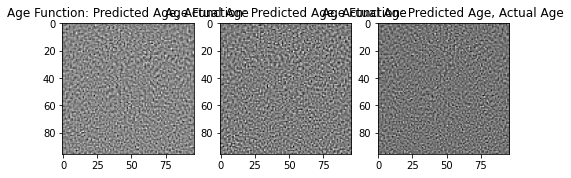

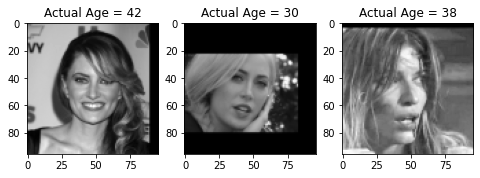

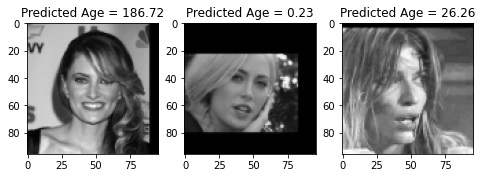

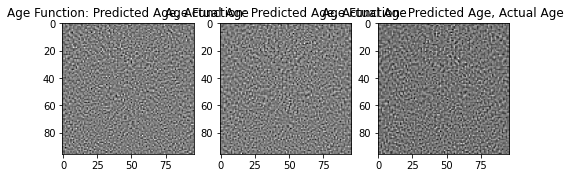

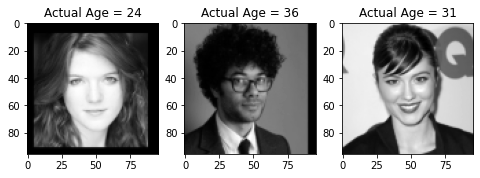

...

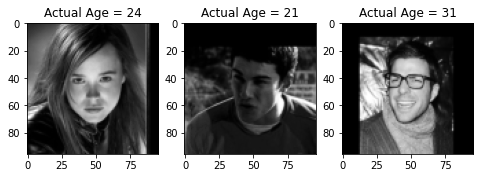

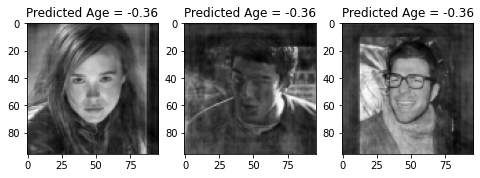

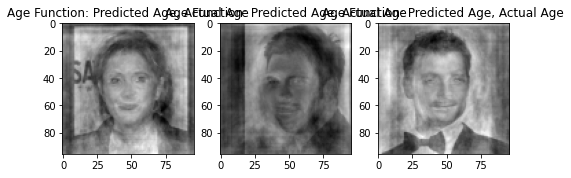

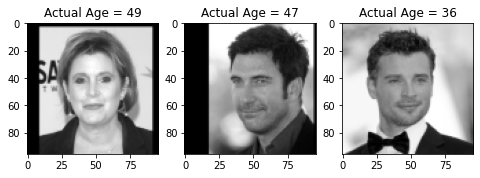

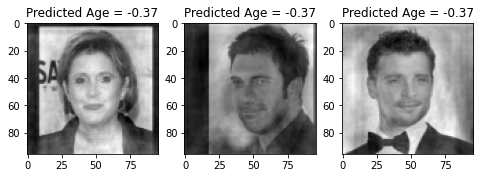

In [314]:
P_pandas = pd.DataFrame(P, columns=list(range(P.shape[1])))
index = newstream_sample['year'].reset_index()

for i in tqdm(np.unique(newstream_sample['hash_sample'])):
    f_now = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) - 11)
    f_p_now = f_now[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
    for offset in np.arange(2000, -2000, -100):
        f_new = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) + offset)
        f_p_new = f_new[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
        
        b_new = b[newstream_sample['hash_sample'] == i] + f_p_new.values.reshape(-1,1) - f_p_now.values.reshape(-1,1)
        
        P_pandas_1 = P_pandas.loc[index.index.values[newstream_sample['hash_sample'] == i], 
                                  index.index.values[newstream_sample['hash_sample'] == i]]
        
        images_syn = images_new.copy().reshape(9216,-1)
        images_syn[newstream_sample['hash_sample'] == i] = P_pandas_1.values.dot(b_new)
        
        new_images = \
        (images_syn[newstream_sample['hash_sample'] == i]) + \
        images_mean[newstream_sample['hash_sample'] == i].reshape(-1,1)
        
        choices = [random.choice(list(range(len(new_images))))]
        array = list(range(len(new_images)))
        for j in range(1,3):
            array.remove(choices[j-1])
            choices.append(random.choice(array))
        
        fig = plt.figure(figsize=(8,16))
        for ii, choice in enumerate(choices):
            plt.subplot(1,3,ii+1)
            plt.imshow(new_images.reshape(-1,96,96)[choice], cmap='gray')
            plt.title("Age Function: Predicted Age, Actual Age")
            
        fig = plt.figure(figsize=(8,16))
        for ii, choice in enumerate(choices):
            plt.subplot(1,3,ii+1)
            plt.imshow(skimage.color.rgb2gray(images[newstream_sample['hash_sample'] == i].reshape(-1,96,96,3))[choice], cmap='gray')
            plt.title("Actual Age = " + \
                      newstream_sample.loc[newstream_sample['hash_sample'] == i, 'age'].iloc[choice].astype(str))
            
        fig = plt.figure(figsize=(8,16))
        for ii, choice in enumerate(choices):
            plt.subplot(1,3,ii+1)
            plt.imshow(skimage.color.rgb2gray(images[newstream_sample['hash_sample'] == i].reshape(-1,96,96,3))[choice] + \
                       new_images.reshape(-1,96,96)[choice], cmap='gray')
            plt.title("Predicted Age = " + str(np.round(f_p_new.iloc[choice], 2)))

## The Aging Function

* Using F1 Score and Recall to measure Drift of the Classifier Model (SVM)

In [326]:
np.linspace(2000, -2000, 10)

array([ 2000.        ,  1555.55555556,  1111.11111111,   666.66666667,
         222.22222222,  -222.22222222,  -666.66666667, -1111.11111111,
       -1555.55555556, -2000.        ])

In [ ]:
import random
import cv2

P_pandas = pd.DataFrame(P, columns=list(range(P.shape[1])))
index = newstream_sample['year'].reset_index()

predictions_classes_array = []
filenames = np.array(list(images_dict.keys()))

for i in tqdm(np.unique(newstream_sample['hash_sample'])):
    f_now = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) - 20)
    f_p_now = f_now[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
    for offset in np.linspace(200, -200, np.ceil(np.sqrt(len(f_p_now))).astype(int)):
        f_new = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) + offset)
        f_p_new = f_new[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
        
        b_new = b[newstream_sample['hash_sample'] == i] + f_p_new.values.reshape(-1,1) - f_p_now.values.reshape(-1,1)
        
        P_pandas_1 = P_pandas.loc[index.index.values[newstream_sample['hash_sample'] == i], 
                                  index.index.values[newstream_sample['hash_sample'] == i]]
                    
        images_syn = images_new.copy().reshape(9216,-1)
        images_syn[newstream_sample['hash_sample'] == i] = P_pandas_1.values.dot(b_new)
        
        new_images = \
        (images_syn[newstream_sample['hash_sample'] == i]) + \
        images_mean[newstream_sample['hash_sample'] == i].reshape(-1,1)
        
#         choices = [random.choice(list(range(len(new_images))))]
#         array = list(range(len(new_images)))
        choices = list(range(0,len(new_images),np.ceil(np.sqrt(len(new_images))).astype(int)))
#             array.remove(choices[j-1])
#             choices.append(random.choice(array))
        
        for ii, choice in enumerate(choices):
            image = new_images[choice].reshape(96,96)
            orig_image = images[newstream_sample['hash_sample'] == i].reshape(-1,96,96,3)[choice]
            orig_bw = skimage.color.rgb2gray(orig_image)
            output_image = orig_bw + image
            output_image = skimage.transform.resize(output_image, (160,160))
            output_image = np.concatenate([np.expand_dims(output_image, 2)]*3, 2)
            orig_bw = skimage.transform.resize(orig_bw, (160,160))
            orig_bw = np.concatenate([np.expand_dims(orig_bw, 2)]*3, 2)
            orig_image = cv2.resize(orig_image, (160,160))
            image = cv2.resize(image, (160,160))
            image = np.concatenate([np.expand_dims(image, 2)]*3, 2)
            res1 = facenet_model(l2_normalize(prewhiten(output_image)).reshape(-1,160,160,3))
            res2 = facenet_model(l2_normalize(prewhiten(orig_bw)).reshape(-1,160,160,3))
            predictions_classes_array.append(
                [i, offset, 
                # identity
                newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity'].iloc[choice], 
                # age
                newstream_sample.loc[newstream_sample['hash_sample'] == i, 'age'].iloc[choice], 
                # filename
                filenames[newstream_sample['hash_sample'] == i][choice], 
                # predicting noised image
                svm_kernel.predict(
                    res1.numpy()
                )[0], 
                # predicting original b/w image
                svm_kernel.predict(
                    res2.numpy()
                )[0], 
                # euclidean distance
                tf.norm(res1 - res2, ord=2).numpy(), 
                # cosine distance
                (tf.matmul(res1, tf.transpose(res2)).numpy() / (tf.norm(res1, ord=2) * tf.norm(res2, ord=2)).numpy())[0][0]]
            )
            print(predictions_classes_array[-1])

  0%|                                                                                                                                                            | 0/4 [00:00<?, ?it/s]

[1.0, 200.0, 572, 51, '51_Amy_Yasbeck_0009.jpg', 572, 572, 0.27806833, 0.9990571]
[1.0, 200.0, 668, 49, '49_Ian_Hart_0006.jpg', 668, 668, 0.3769041, 0.99822843]
[1.0, 200.0, 794, 46, '46_Mary_Stuart_Masterson_0008.jpg', 794, 794, 0.21949118, 0.99891436]
[1.0, 200.0, 949, 43, '43_Alexandra_Hedison_0001.jpg', 949, 949, 1.0629429, 0.9894163]
[1.0, 200.0, 1250, 37, '37_Georgina_Cates_0005.jpg', 1250, 1250, 0.19885592, 0.9997686]
[1.0, 200.0, 1442, 31, '31_Mary_Elizabeth_Ellis_0001.jpg', 1442, 1442, 0.5322663, 0.99656063]
[1.0, 200.0, 1695, 27, '27_Martha_MacIsaac_0015.jpg', 1695, 1695, 0.20144641, 0.99948144]
[1.0, 200.0, 1801, 26, '26_Evan_Peters_0005.jpg', 1801, 1801, 0.48028114, 0.99685866]
[1.0, 200.0, 1937, 24, '24_Alex_D._Linz_0004.jpg', 1937, 1937, 0.9710983, 0.98317534]
[1.0, 150.0, 572, 51, '51_Amy_Yasbeck_0009.jpg', 572, 572, 0.27806833, 0.9990571]
[1.0, 150.0, 668, 49, '49_Ian_Hart_0006.jpg', 668, 668, 0.3769041, 0.99822843]
[1.0, 150.0, 794, 46, '46_Mary_Stuart_Masterson_0008.j

 25%|████████████████████████████████████▊                                                                                                              | 1/4 [03:51<11:33, 231.05s/it]

[1.0, -200.0, 1937, 24, '24_Alex_D._Linz_0004.jpg', 1937, 1937, 0.9710983, 0.98317534]
[2.0, 200.0, 20, 56, '56_Joe_Pantoliano_0004.jpg', 20, 20, 0.55519116, 0.9922371]
[2.0, 200.0, 76, 59, "59_Terry_O'Quinn_0009.jpg", 76, 76, 2.9362528, 0.9127495]
[2.0, 200.0, 126, 59, '59_Colleen_Camp_0005.jpg', 126, 126, 1.3661869, 0.978453]
[2.0, 200.0, 198, 59, '59_Bill_Mumy_0010.jpg', 198, 198, 1.5296725, 0.9610955]
[2.0, 200.0, 335, 56, '56_Andrew_Dice_Clay_0013.jpg', 335, 335, 1.7595699, 0.9472257]
[2.0, 200.0, 469, 52, '52_Tracy_Pollan_0001.jpg', 469, 469, 1.6510711, 0.9605886]
[2.0, 200.0, 520, 52, '52_Raymond_Cruz_0012.jpg', 172, 172, 0.2728691, 0.99831635]
[2.0, 142.85714285714286, 20, 56, '56_Joe_Pantoliano_0004.jpg', 20, 20, 0.55519116, 0.9922371]
[2.0, 142.85714285714286, 76, 59, "59_Terry_O'Quinn_0009.jpg", 76, 76, 2.9362528, 0.9127495]
[2.0, 142.85714285714286, 126, 59, '59_Colleen_Camp_0005.jpg', 126, 126, 1.3661869, 0.978453]
[2.0, 142.85714285714286, 198, 59, '59_Bill_Mumy_0010.jpg'

 50%|█████████████████████████████████████████████████████████████████████████▌                                                                         | 2/4 [06:28<06:15, 187.82s/it]

[2.0, -200.0, 520, 52, '52_Raymond_Cruz_0012.jpg', 172, 172, 0.2728691, 0.99831635]
[3.0, 200.0, 1, 53, '53_Robin_Williams_0002.jpg', 1200, 1, 1.5193164, 0.95231456]
[3.0, 200.0, 48, 59, '59_Jean_Smart_0012.jpg', 393, 48, 3.1229138, 0.92099303]
[3.0, 200.0, 86, 58, '58_Alfre_Woodard_0004.jpg', 1366, 86, 1.4972005, 0.967484]
[3.0, 200.0, 147, 58, '58_Robert_Wisdom_0007.jpg', 302, 361, 1.0313053, 0.97468007]
[3.0, 200.0, 190, 58, '58_Michael_Moore_0014.jpg', 1273, 190, 3.252858, 0.81936604]
[3.0, 200.0, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 200.0, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 200.0, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 200.0, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 200.0, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 200.0, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 2

[3.0, 193.65079365079364, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 193.65079365079364, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 193.65079365079364, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 193.65079365079364, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 193.65079365079364, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 193.65079365079364, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 193.65079365079364, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 193.65079365079364, 1204, 32, '32_Angelina_Jolie_0019.jpg', 1146, 1204, 1.9556975, 0.94157434]
[3.0, 193.65079365079364, 1226, 36, '36_Jolene_Blalock_0009.jpg', 177, 1226, 2.208761, 0.91603386]
[3.0, 193.65079365079364, 1258, 35, '35_Daniel_Gillies_0008.jpg', 170, 518, 2.261057, 0.87251055]
[3.0, 193.650793650

[3.0, 187.3015873015873, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 187.3015873015873, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 187.3015873015873, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 187.3015873015873, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 187.3015873015873, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 187.3015873015873, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 187.3015873015873, 1763, 21, '21_Emily_VanCamp_0006.jpg', 686, 1763, 2.8456454, 0.8321195]
[3.0, 187.3015873015873, 1788, 24, '24_Monica_Raymund_0013.jpg', 172, 1788, 2.4666429, 0.8899634]
[3.0, 187.3015873015873, 1817, 23, '23_Evan_Rachel_Wood_0010.jpg', 470, 1817, 2.9355385, 0.821079]
[3.0, 187.3015873015873, 1841, 20, '20_William_Moseley_0001.jpg', 566, 1841, 4.2405024, 0.7827362]
[3.0, 187.3015873015873, 

[3.0, 174.6031746031746, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 174.6031746031746, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 174.6031746031746, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 174.6031746031746, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 174.6031746031746, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 174.6031746031746, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 174.6031746031746, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 174.6031746031746, 564, 45, '45_Ally_Sheedy_0004.jpg', 667, 564, 1.4431819, 0.9583061]
[3.0, 174.6031746031746, 604, 45, '45_Elisabeth_Shue_0008.jpg', 1531, 604, 2.3318663, 0.8938031]
[3.0, 174.6031746031746, 634, 43, '43_William_Baldwin_0015.jpg', 1006, 361, 0.8532768, 0.9846552]
[3.0, 174.6031746031746, 664, 44, '44_Mar

[3.0, 168.25396825396825, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 168.25396825396825, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 168.25396825396825, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 168.25396825396825, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 168.25396825396825, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 168.25396825396825, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 168.25396825396825, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 168.25396825396825, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 168.25396825396825, 1204, 32, '32_Angelina_Jolie_0019.jpg', 1146, 1204, 1.9556975, 0.94157434]
[3.0, 168.25396825396825, 1226, 36, '36_Jolene_Blalock_0009.jpg', 177, 1226, 2.208761, 0.91603386]
[3.0, 168.253968253

[3.0, 161.9047619047619, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 161.9047619047619, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 161.9047619047619, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 161.9047619047619, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 161.9047619047619, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 161.9047619047619, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 161.9047619047619, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 161.9047619047619, 1763, 21, '21_Emily_VanCamp_0006.jpg', 686, 1763, 2.8456454, 0.8321195]
[3.0, 161.9047619047619, 1788, 24, '24_Monica_Raymund_0013.jpg', 172, 1788, 2.4666429, 0.8899634]
[3.0, 161.9047619047619, 1817, 23, '23_Evan_Rachel_Wood_0010.jpg', 470, 1817, 2.9355385, 0.821079]
[3.0, 161.9047619047619, 1

[3.0, 149.20634920634922, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 149.20634920634922, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 149.20634920634922, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 149.20634920634922, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 149.20634920634922, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 149.20634920634922, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 149.20634920634922, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 149.20634920634922, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 149.20634920634922, 564, 45, '45_Ally_Sheedy_0004.jpg', 667, 564, 1.4431819, 0.9583061]
[3.0, 149.20634920634922, 604, 45, '45_Elisabeth_Shue_0008.jpg', 1531, 604, 2.3318663, 0.8938031]
[3.0, 149.20634920634922, 634, 43, 

[3.0, 142.85714285714286, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 142.85714285714286, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 142.85714285714286, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 142.85714285714286, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 142.85714285714286, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 142.85714285714286, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 142.85714285714286, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 142.85714285714286, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 142.85714285714286, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 142.85714285714286, 1204, 32, '32_Angelina_Jolie_0019.jpg', 1146, 1204, 1.9556975, 0.94157434]
[3.0, 142.8571428571428

[3.0, 136.5079365079365, 1531, 29, '29_Britney_Spears_0004.jpg', 1707, 1531, 3.7906253, 0.88257927]
[3.0, 136.5079365079365, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 136.5079365079365, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 136.5079365079365, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 136.5079365079365, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 136.5079365079365, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 136.5079365079365, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 136.5079365079365, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 136.5079365079365, 1763, 21, '21_Emily_VanCamp_0006.jpg', 686, 1763, 2.8456454, 0.8321195]
[3.0, 136.5079365079365, 1788, 24, '24_Monica_Raymund_0013.jpg', 172, 1788, 2.4666429, 0.8899634]
[3.0, 136.5079365079365, 

[3.0, 123.80952380952381, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 123.80952380952381, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 123.80952380952381, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 123.80952380952381, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 123.80952380952381, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 123.80952380952381, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 123.80952380952381, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 123.80952380952381, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 123.80952380952381, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 123.80952380952381, 564, 45, '45_Ally_Sheedy_0004.jpg', 667, 564, 1.4431819, 0.9583061]
[3.0, 123.80952380952381, 604, 45, 

[3.0, 117.46031746031747, 932, 41, '41_Josh_Holloway_0013.jpg', 1513, 932, 4.002447, 0.7863906]
[3.0, 117.46031746031747, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 117.46031746031747, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 117.46031746031747, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 117.46031746031747, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 117.46031746031747, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 117.46031746031747, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 117.46031746031747, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 117.46031746031747, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 117.46031746031747, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 117.46031746031747, 12

[3.0, 111.11111111111111, 1477, 33, '33_Kim_Kardashian_0002.jpg', 1151, 1477, 2.23775, 0.9199425]
[3.0, 111.11111111111111, 1507, 30, '30_Jessica_Alba_0014.jpg', 1826, 1507, 3.3856113, 0.85570407]
[3.0, 111.11111111111111, 1531, 29, '29_Britney_Spears_0004.jpg', 1707, 1531, 3.7906253, 0.88257927]
[3.0, 111.11111111111111, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 111.11111111111111, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 111.11111111111111, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 111.11111111111111, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 111.11111111111111, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 111.11111111111111, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 111.11111111111111, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 111.11111

[3.0, 98.41269841269842, 190, 58, '58_Michael_Moore_0014.jpg', 1273, 190, 3.252858, 0.81936604]
[3.0, 98.41269841269842, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 98.41269841269842, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 98.41269841269842, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 98.41269841269842, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 98.41269841269842, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 98.41269841269842, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 98.41269841269842, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 98.41269841269842, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 98.41269841269842, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 98.41269841269842, 564, 45, '45_Ally

[3.0, 92.06349206349206, 932, 41, '41_Josh_Holloway_0013.jpg', 1513, 932, 4.002447, 0.7863906]
[3.0, 92.06349206349206, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 92.06349206349206, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 92.06349206349206, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 92.06349206349206, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 92.06349206349206, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 92.06349206349206, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 92.06349206349206, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 92.06349206349206, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 92.06349206349206, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 92.06349206349206, 1204, 32, '32

[3.0, 85.71428571428572, 1507, 30, '30_Jessica_Alba_0014.jpg', 1826, 1507, 3.3856113, 0.85570407]
[3.0, 85.71428571428572, 1531, 29, '29_Britney_Spears_0004.jpg', 1707, 1531, 3.7906253, 0.88257927]
[3.0, 85.71428571428572, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 85.71428571428572, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 85.71428571428572, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 85.71428571428572, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 85.71428571428572, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 85.71428571428572, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 85.71428571428572, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 85.71428571428572, 1763, 21, '21_Emily_VanCamp_0006.jpg', 686, 1763, 2.8456454, 0.8321195]
[3.0, 85.71428571428572, 

[3.0, 73.01587301587303, 190, 58, '58_Michael_Moore_0014.jpg', 1273, 190, 3.252858, 0.81936604]
[3.0, 73.01587301587303, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 73.01587301587303, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 73.01587301587303, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 73.01587301587303, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 73.01587301587303, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 73.01587301587303, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 73.01587301587303, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 73.01587301587303, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 73.01587301587303, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 73.01587301587303, 564, 45, '45_Ally

[3.0, 66.66666666666669, 932, 41, '41_Josh_Holloway_0013.jpg', 1513, 932, 4.002447, 0.7863906]
[3.0, 66.66666666666669, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 66.66666666666669, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 66.66666666666669, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 66.66666666666669, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 66.66666666666669, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 66.66666666666669, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 66.66666666666669, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 66.66666666666669, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 66.66666666666669, 1171, 36, '36_Jenna_Fischer_0005.jpg', 291, 1171, 3.985449, 0.78839564]
[3.0, 66.66666666666669, 1204, 32, '32

[3.0, 60.31746031746033, 1507, 30, '30_Jessica_Alba_0014.jpg', 1826, 1507, 3.3856113, 0.85570407]
[3.0, 60.31746031746033, 1531, 29, '29_Britney_Spears_0004.jpg', 1707, 1531, 3.7906253, 0.88257927]
[3.0, 60.31746031746033, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 60.31746031746033, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 60.31746031746033, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 60.31746031746033, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 60.31746031746033, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 60.31746031746033, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 60.31746031746033, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 60.31746031746033, 1763, 21, '21_Emily_VanCamp_0006.jpg', 686, 1763, 2.8456454, 0.8321195]
[3.0, 60.31746031746033, 

[3.0, 47.61904761904762, 190, 58, '58_Michael_Moore_0014.jpg', 1273, 190, 3.252858, 0.81936604]
[3.0, 47.61904761904762, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 47.61904761904762, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 47.61904761904762, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 47.61904761904762, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 47.61904761904762, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 47.61904761904762, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 47.61904761904762, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 47.61904761904762, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 47.61904761904762, 526, 52, '52_Ricky_Gervais_0002.jpg', 307, 171, 1.8399684, 0.9374567]
[3.0, 47.61904761904762, 564, 45, '45_Ally

[3.0, 41.269841269841265, 909, 42, '42_Laurie_Holden_0004.jpg', 1110, 909, 3.213262, 0.78596526]
[3.0, 41.269841269841265, 932, 41, '41_Josh_Holloway_0013.jpg', 1513, 932, 4.002447, 0.7863906]
[3.0, 41.269841269841265, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 41.269841269841265, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 41.269841269841265, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 41.269841269841265, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 41.269841269841265, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]
[3.0, 41.269841269841265, 1093, 37, '37_Eli_Roth_0011.jpg', 341, 1093, 4.3816223, 0.84376335]
[3.0, 41.269841269841265, 1119, 39, '39_T.R._Knight_0003.jpg', 1119, 1119, 2.0567505, 0.89718145]
[3.0, 41.269841269841265, 1152, 31, '31_Christian_Bale_0011.jpg', 858, 858, 1.2578077, 0.96752775]
[3.0, 41.269841269841265, 117

[3.0, 34.92063492063494, 1477, 33, '33_Kim_Kardashian_0002.jpg', 1151, 1477, 2.23775, 0.9199425]
[3.0, 34.92063492063494, 1507, 30, '30_Jessica_Alba_0014.jpg', 1826, 1507, 3.3856113, 0.85570407]
[3.0, 34.92063492063494, 1531, 29, '29_Britney_Spears_0004.jpg', 1707, 1531, 3.7906253, 0.88257927]
[3.0, 34.92063492063494, 1559, 25, '25_Cory_Monteith_0007.jpg', 1439, 1559, 4.9169655, 0.5848564]
[3.0, 34.92063492063494, 1582, 31, '31_Martin_Starr_0004.jpg', 761, 1582, 4.197619, 0.76589817]
[3.0, 34.92063492063494, 1608, 30, '30_Emily_Blunt_0010.jpg', 829, 1093, 2.108266, 0.88715196]
[3.0, 34.92063492063494, 1637, 27, '27_Rebecca_Ferguson_0001.jpg', 416, 1637, 3.1597579, 0.87465]
[3.0, 34.92063492063494, 1672, 26, '26_Rachael_Taylor_0015.jpg', 1606, 1672, 4.1527853, 0.68335456]
[3.0, 34.92063492063494, 1707, 25, '25_Amanda_Seyfried_0011.jpg', 1807, 1707, 2.199897, 0.91483635]
[3.0, 34.92063492063494, 1743, 27, '27_Bug_Hall_0001.jpg', 821, 1743, 2.5697846, 0.89777607]
[3.0, 34.92063492063494, 

[3.0, 22.22222222222223, 147, 58, '58_Robert_Wisdom_0007.jpg', 302, 361, 1.0313053, 0.97468007]
[3.0, 22.22222222222223, 190, 58, '58_Michael_Moore_0014.jpg', 1273, 190, 3.252858, 0.81936604]
[3.0, 22.22222222222223, 225, 58, '58_Roland_Emmerich_0004.jpg', 502, 225, 1.0138535, 0.9769116]
[3.0, 22.22222222222223, 258, 50, '50_Dana_Delany_0006.jpg', 563, 258, 1.1213832, 0.96996284]
[3.0, 22.22222222222223, 300, 56, '56_Wendy_Crewson_0009.jpg', 1437, 300, 3.1251612, 0.82519984]
[3.0, 22.22222222222223, 346, 49, '49_Kevin_Pollak_0015.jpg', 768, 346, 2.2932584, 0.92359704]
[3.0, 22.22222222222223, 377, 55, '55_Linda_Fiorentino_0002.jpg', 956, 377, 2.181409, 0.929283]
[3.0, 22.22222222222223, 422, 53, '53_Ving_Rhames_0004.jpg', 567, 567, 1.1253623, 0.969266]
[3.0, 22.22222222222223, 460, 50, '50_Antonio_Banderas_0004.jpg', 907, 1539, 1.4047587, 0.9548733]
[3.0, 22.22222222222223, 502, 49, '49_George_Clooney_0015.jpg', 349, 502, 3.2028487, 0.81749314]
[3.0, 22.22222222222223, 526, 52, '52_Ric

[3.0, 15.873015873015873, 874, 42, '42_Dina_Meyer_0015.jpg', 1101, 874, 1.6985896, 0.94916415]
[3.0, 15.873015873015873, 909, 42, '42_Laurie_Holden_0004.jpg', 1110, 909, 3.213262, 0.78596526]
[3.0, 15.873015873015873, 932, 41, '41_Josh_Holloway_0013.jpg', 1513, 932, 4.002447, 0.7863906]
[3.0, 15.873015873015873, 959, 43, '43_Ethan_Hawke_0008.jpg', 170, 1917, 1.7537147, 0.9338797]
[3.0, 15.873015873015873, 993, 40, '40_Joseph_Fiennes_0008.jpg', 211, 993, 3.1051152, 0.80757326]
[3.0, 15.873015873015873, 1016, 40, '40_Peter_Sarsgaard_0001.jpg', 1016, 1016, 1.1826332, 0.97353196]
[3.0, 15.873015873015873, 1040, 36, '36_Jenna_Elfman_0002.jpg', 820, 1040, 3.093606, 0.81852937]
[3.0, 15.873015873015873, 1068, 41, '41_Missi_Pyle_0005.jpg', 344, 1068, 2.4784422, 0.9035461]


In [3]:
import pandas as pd

predictions_classes = pd.DataFrame(predictions_classes_array, 
                                   columns=['hash_sample', 'offset', 'true_identity', 'age', 'filename', 
                                   'y_pred', 'y_drift', 'euclidean', 'cosine'])

In [7]:
predictions_classes.to_csv("drift_synthesis_eda_predictions_classes.csv")

## Formulated Age

In [234]:
f_new = (w.T.dot(b) + 11)
f_new

array([52.99998935, 58.00000525, 61.00000258, ..., 20.99995689,
       21.99998184, 23.00003996])

In [233]:
w.T.dot(b) + 11 - stream_sample['age']

identity  age
1         53    -1.064501e-05
          58     5.246201e-06
          61     2.576329e-06
          62    -6.157788e-07
2         54    -7.800409e-07
                     ...     
1999      15     9.062238e-06
          16    -2.006372e-05
          21    -4.311026e-05
2000      22    -1.815535e-05
          23     3.995519e-05
Name: age, Length: 9216, dtype: float64

## Confidence Intervals of Predicted Age and Euclidean / Cosine Distance

In [358]:
age_sem = newstream_sample.groupby('hash_sample')['age'].sem()
age_mean = newstream_sample.groupby('hash_sample')['age'].mean()

confidence_intervals_predicted_age = []

for i in tqdm(np.unique(newstream_sample['hash_sample'])):
    f_now = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) - 20)
    f_p_now = f_now[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
    for offset in np.arange(20000, -20000, -2000):
        f_new = newstream_sample['identity_grouping_distance'] * (w.T.dot(b) + offset)
        f_p_new = f_new[newstream_sample['hash_sample'] == i] / \
        np.sum(newstream_sample.loc[newstream_sample['hash_sample'] == i, 'identity_grouping_distance'])
        
        b_new = b[newstream_sample['hash_sample'] == i] + f_p_new.values.reshape(-1,1) - f_p_now.values.reshape(-1,1)
        w_filter = w[newstream_sample['hash_sample'] == i]
        
        predicted_age = pd.Series((w_filter.T.dot(b_new) + 11))
        confidence_intervals_predicted_age.append(
            [
                predicted_age.mean(), predicted_age.std(), predicted_age.sem(), i, offset, age_sem.loc[float(i)], age_mean.loc[float(i)]
            ]
        )
confidence_intervals_predicted_age = pd.DataFrame(confidence_intervals_predicted_age, columns=[
    'predicted_age_mean', 'predicted_age_std', 'predicted_age_sem', 'hash_sample', 'offset', 'age_sem', 'age_mean'
])

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:22<00:00,  5.59s/it]


In [359]:
confidence_intervals_predicted_age

,predicted_age_mean,predicted_age_std,predicted_age_sem,hash_sample,offset,age_sem,age_mean
0,9.487472e+06,4.998503e+06,52067.740553,1.0,20000,1.113242,35.379747
1,8.539670e+06,4.998503e+06,52067.740553,1.0,18000,1.113242,35.379747
2,7.591867e+06,4.998503e+06,52067.740553,1.0,16000,1.113242,35.379747
3,6.644065e+06,4.998503e+06,52067.740553,1.0,14000,1.113242,35.379747
4,5.696263e+06,4.998503e+06,52067.740553,1.0,12000,1.113242,35.379747
...,...,...,...,...,...,...,...
75,6.356985e+09,1.108420e+06,11546.044290,4.0,-10000,0.164155,38.305068
76,7.630930e+09,1.108420e+06,11546.044290,4.0,-12000,0.164155,38.305068
77,8.904875e+09,1.108420e+06,11546.044290,4.0,-14000,0.164155,38.305068
78,1.017882e+10,1.108420e+06,11546.044290,4.0,-16000,0.164155,38.305068


In [360]:
predictions_classes

,hash_sample,offset,true_identity,age,filename,y_pred,y_drift,euclidean,cosine
0,1.0,200.0,572,51,51_Amy_Yasbeck_0009.jpg,572,572,0.278068,0.999057
1,1.0,200.0,668,49,49_Ian_Hart_0006.jpg,668,668,0.376904,0.998228
2,1.0,200.0,794,46,46_Mary_Stuart_Masterson_0008.jpg,794,794,0.219491,0.998914
3,1.0,200.0,949,43,43_Alexandra_Hedison_0001.jpg,949,949,1.062943,0.989416
4,1.0,200.0,1250,37,37_Georgina_Cates_0005.jpg,1250,1250,0.198856,0.999769
...,...,...,...,...,...,...,...,...,...
9269,4.0,-200.0,1862,25,25_Mae_Whitman_0015.jpg,1232,1862,1.571131,0.969013
9270,4.0,-200.0,1890,25,25_Jessica_Lowndes_0011.jpg,1560,1890,4.483027,0.746801
9271,4.0,-200.0,1914,24,24_Ashley_Benson_0008.jpg,1316,1914,1.500743,0.950213
9272,4.0,-200.0,1942,23,23_Cody_Linley_0003.jpg,1729,1942,7.938746,0.318122


In [368]:
combined_predictions_classes = predictions_classes.copy()

combined_predictions_classes['age_mean'] = 0.0
combined_predictions_classes['age_sem'] = 0.0
combined_predictions_classes['predicted_age_mean'] = 0.0
combined_predictions_classes['predicted_age_std'] = 0.0
combined_predictions_classes['predicted_age_sem'] = 0.0
for i in tqdm(np.unique(newstream_sample['hash_sample'])):
    for offset in np.arange(20000, -20000, -2000):
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & \
                                        (combined_predictions_classes['offset'] == offset), 'age_mean'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
            (confidence_intervals_predicted_age['offset'] == offset), 'age_mean'].iloc[0]
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & \
                                        (combined_predictions_classes['offset'] == offset), 'age_mean'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
                                               (confidence_intervals_predicted_age['offset'] == offset), 'age_mean'].iloc[0]
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & 
                                        (combined_predictions_classes['offset'] == offset), 'age_sem'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
                                               (confidence_intervals_predicted_age['offset'] == offset), 'age_sem'].iloc[0]
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & 
                                        (combined_predictions_classes['offset'] == offset), 'predicted_age_mean'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
                                               (confidence_intervals_predicted_age['offset'] == offset), 'predicted_age_mean'].iloc[0]
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & 
                                        (combined_predictions_classes['offset'] == offset), 'predicted_age_std'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
                                               (confidence_intervals_predicted_age['offset'] == offset), 'predicted_age_std'].iloc[0]
        combined_predictions_classes.loc[(combined_predictions_classes['hash_sample'] == i) & 
                                        (combined_predictions_classes['offset'] == offset), 'predicted_age_sem'] = \
        confidence_intervals_predicted_age.loc[(confidence_intervals_predicted_age['hash_sample'] == i) & 
                                               (confidence_intervals_predicted_age['offset'] == offset), 'predicted_age_sem'].iloc[0]

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  5.18it/s]


In [369]:
combined_predictions_classes

,hash_sample,offset,true_identity,age,filename,y_pred,y_drift,euclidean,cosine,TP,TN,FP,FN,age_mean,age_sem,predicted_age_mean,predicted_age_std,predicted_age_sem
0,1.0,200.0,572,51,51_Amy_Yasbeck_0009.jpg,572,572,0.278068,0.999057,1,0,0,0,0.0,0.0,0.0,0.0,0.0
1,1.0,200.0,668,49,49_Ian_Hart_0006.jpg,668,668,0.376904,0.998228,1,0,0,0,0.0,0.0,0.0,0.0,0.0
2,1.0,200.0,794,46,46_Mary_Stuart_Masterson_0008.jpg,794,794,0.219491,0.998914,1,0,0,0,0.0,0.0,0.0,0.0,0.0
3,1.0,200.0,949,43,43_Alexandra_Hedison_0001.jpg,949,949,1.062943,0.989416,1,0,0,0,0.0,0.0,0.0,0.0,0.0
4,1.0,200.0,1250,37,37_Georgina_Cates_0005.jpg,1250,1250,0.198856,0.999769,1,0,0,0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9269,4.0,-200.0,1862,25,25_Mae_Whitman_0015.jpg,1232,1862,1.571131,0.969013,0,0,0,1,0.0,0.0,0.0,0.0,0.0
9270,4.0,-200.0,1890,25,25_Jessica_Lowndes_0011.jpg,1560,1890,4.483027,0.746801,0,0,0,1,0.0,0.0,0.0,0.0,0.0
9271,4.0,-200.0,1914,24,24_Ashley_Benson_0008.jpg,1316,1914,1.500743,0.950213,0,0,0,1,0.0,0.0,0.0,0.0,0.0
9272,4.0,-200.0,1942,23,23_Cody_Linley_0003.jpg,1729,1942,7.938746,0.318122,0,0,0,1,0.0,0.0,0.0,0.0,0.0


## CI of Predicted Aging Function vs Euclidean Distance

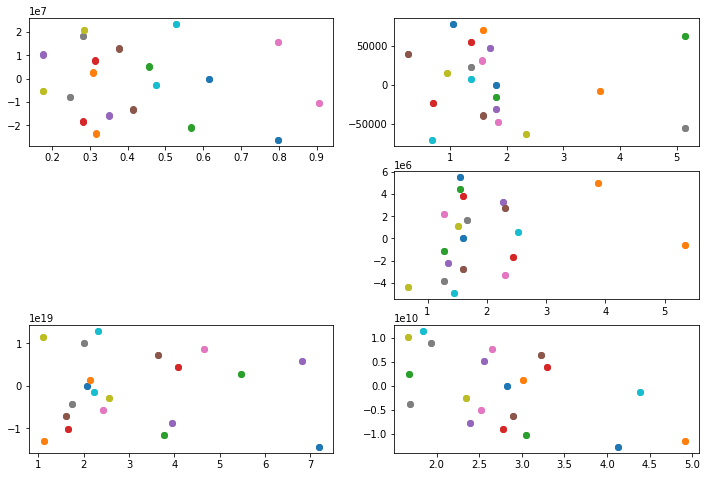

In [274]:
fig = plt.figure(figsize=(12,8))
for i in np.unique(newstream_sample['hash_sample']):
    plt.subplot(3,2,int(i))
    for offset in np.arange(20000, -20000, -2000):
        mean_age = combined_predictions_classes.loc[
            (combined_predictions_classes['hash_sample'] == i) & (combined_predictions_classes['offset'] == offset), 
        'predicted_age_mean'].iloc[0]
        sem_age = combined_predictions_classes.loc[
            (combined_predictions_classes['hash_sample'] == i) & (combined_predictions_classes['offset'] == offset), 
        'predicted_age_sem'].iloc[0]
        euclidean = combined_predictions_classes.loc[
            (combined_predictions_classes['hash_sample'] == i) & (combined_predictions_classes['offset'] == offset), 
        'euclidean'].iloc[0]
        plt.plot([euclidean]*2, [mean_age-1.96*sem_age, mean_age+1.96*sem_age], marker='o', ls='-')

In [4]:
predictions_classes['TP'] = 0
predictions_classes.loc[(predictions_classes['y_pred'] == predictions_classes['true_identity']) & \
                        (predictions_classes['true_identity'] == predictions_classes['y_drift']) & \
                        (predictions_classes['y_pred'] == predictions_classes['y_drift']), 'TP'] = 1
predictions_classes['TN'] = 0
predictions_classes.loc[(predictions_classes['y_pred'] == predictions_classes['true_identity']) & \
                        (predictions_classes['y_drift'] != predictions_classes['true_identity']) & \
                        (predictions_classes['y_pred'] == predictions_classes['y_drift']), 'TN'] = 1
predictions_classes['FP'] = 0
predictions_classes.loc[(predictions_classes['y_pred'] == predictions_classes['true_identity']) & \
                        (predictions_classes['y_drift'] != predictions_classes['true_identity']) & \
                        (predictions_classes['y_pred'] != predictions_classes['y_drift']), 'FP'] = 1
predictions_classes['FN'] = 0
predictions_classes.loc[(predictions_classes['y_pred'] != predictions_classes['y_drift']) & \
                        (predictions_classes['y_drift'] == predictions_classes['true_identity']) & \
                        (predictions_classes['y_pred'] != predictions_classes['y_drift']), 'FN'] = 1

In [5]:
recall = predictions_classes['TP'].sum() / (predictions_classes['TP'].sum() + predictions_classes['FN'].sum())
precision = predictions_classes['TP'].sum() / (predictions_classes['TP'].sum() + predictions_classes['FP'].sum())
accuracy = (predictions_classes['TP'].sum() + predictions_classes['TN'].sum()) / \
(predictions_classes['TP'].sum() + predictions_classes['TN'].sum() + predictions_classes['FP'].sum() + predictions_classes['FN'].sum())
print("""
    Recall: {recall}, 
    Precision: {precision}, 
    F1: {f1},  
    Accuracy: {accuracy}
""".format(
    accuracy=accuracy, 
    f1=2 * recall * precision / (recall + precision), 
    precision=predictions_classes['TP'].sum() / (predictions_classes['TP'].sum() + predictions_classes['FP'].sum()), 
    recall=predictions_classes['TP'].sum() / (predictions_classes['TP'].sum() + predictions_classes['FN'].sum())
))


    Recall: 0.13140446051838456, 
    Precision: 1.0, 
    F1: 0.23228556206712836,  
    Accuracy: 0.13140446051838456



In [6]:
conf_mat = predictions_classes[['TP', 'FN', 'FP', 'TN', 'hash_sample']].groupby('hash_sample').sum()
for i in conf_mat.index:
    recall = (conf_mat.loc[conf_mat.index == i]['TP'] / (conf_mat.loc[conf_mat.index == i]['TP'] + \
                                                                conf_mat.loc[conf_mat.index == i]['FN'])).iloc[0]
    precision = (conf_mat.loc[conf_mat.index == i]['TP'] / (conf_mat.loc[conf_mat.index == i]['TP'] + \
                                                                conf_mat.loc[conf_mat.index == i]['FP'])).iloc[0]
    accuracy = ((conf_mat.loc[conf_mat.index == i]['TP'] + conf_mat.loc[conf_mat.index == i]['TN']) / \
    (conf_mat.loc[conf_mat.index == i]['TP'] + \
            conf_mat.loc[conf_mat.index == i]['TN'] + \
              conf_mat.loc[conf_mat.index == i]['FN'] + \
              conf_mat.loc[conf_mat.index == i]['FP'])).iloc[0]
    print("""
    Hash Sample: {i}, 
    Recall: {recall}, 
    Precision: {precision}, 
    F1: {f1},  
    Accuracy: {accuracy}
    """.format(accuracy=accuracy, f1=(2*precision*recall)/(precision+recall), recall=recall, precision=precision,i=i))


    Hash Sample: 1.0, 
    Recall: 1.0, 
    Precision: 1.0, 
    F1: 1.0,  
    Accuracy: 1.0
    

    Hash Sample: 2.0, 
    Recall: 1.0, 
    Precision: 1.0, 
    F1: 1.0,  
    Accuracy: 1.0
    

    Hash Sample: 3.0, 
    Recall: 0.05816993464052288, 
    Precision: 1.0, 
    F1: 0.1099444101297097,  
    Accuracy: 0.05816993464052288
    


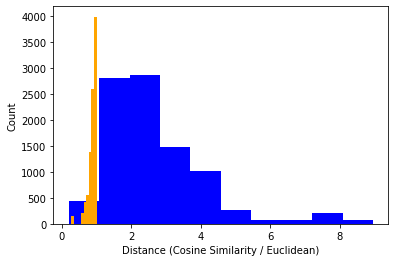

In [366]:
plt.hist(predictions_classes['euclidean'], color='blue')
plt.hist(predictions_classes['cosine'], color='orange')
plt.xlabel("Distance (Cosine Similarity / Euclidean)")
plt.ylabel("Count")
plt.show()

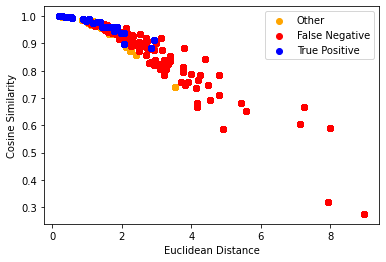

In [367]:
plt.scatter(predictions_classes.loc[(predictions_classes['TP'] != 1) & \
                                    (predictions_classes['FN'] != 1), 'euclidean'], 
            predictions_classes.loc[(predictions_classes['FN'] != 1) & \
                  (predictions_classes['TP'] != 1), 'cosine'], c='orange', label='Other')
plt.scatter(predictions_classes.loc[predictions_classes['FN'] == 1, 'euclidean'], predictions_classes.loc[predictions_classes['FN'] == 1, 'cosine'], c='red', label='False Negative')
plt.scatter(predictions_classes.loc[predictions_classes['TP'] == 1, 'euclidean'], predictions_classes.loc[predictions_classes['TP'] == 1, 'cosine'], c='blue', label='True Positive')
plt.legend()
plt.xlabel("Euclidean Distance")
plt.ylabel("Cosine Similarity")
plt.show()

In [8]:
cumulative_metric = predictions_classes[['TP', 'FN', 'FP', 'TN']].cumsum()

In [16]:
cumulative_metric['recall'] = cumulative_metric['TP'] / (cumulative_metric['TP'] + cumulative_metric['FN'])
cumulative_metric['precision'] = cumulative_metric['TP'] / (cumulative_metric['TP'] + cumulative_metric['FP'])
cumulative_metric['accuracy'] = (cumulative_metric['TP'] + cumulative_metric['TN']) / \
(cumulative_metric['TP'] + cumulative_metric['TN'] + cumulative_metric['FP'] + cumulative_metric['FN'])

## Levels of Drift, When Drift Happened?

### Using Euclidean Distance

C:\Users\burse\anaconda3\envs\keras_env\lib\site-packages\ipykernel_launcher.py:18: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


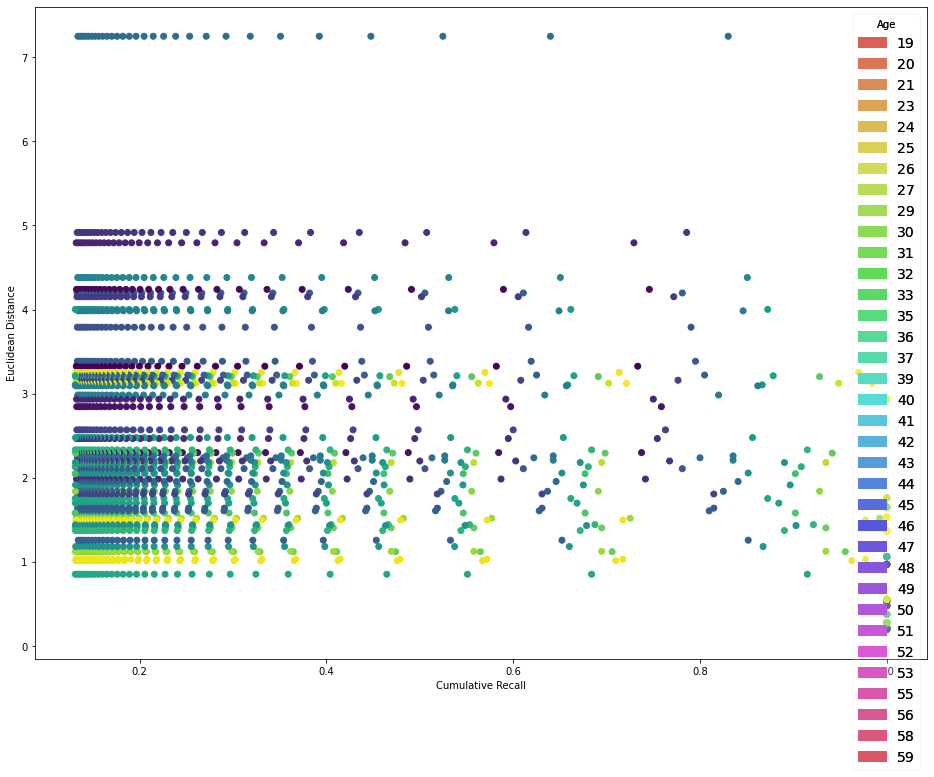

In [53]:
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
import seaborn as sns
import numpy as np

colors = sns.color_palette("hls", len(np.unique(predictions_classes['age'])))

fig, ax = plt.subplots(1,1,figsize=(16,12))
ax.scatter(cumulative_metric['recall'], predictions_classes['euclidean'], c=predictions_classes['age'])
# create custom legend, by creating custom lines
custom_lines = [Circle((0,0), 5, color=colors[of]) for of in range(len(np.unique(predictions_classes['age'])))]
# create legend using custom lines
legend1 = ax.legend(custom_lines, np.unique(predictions_classes['age']), loc="upper right", title="Age", framealpha=0.1, fontsize=14)
# add legend to axis
ax.add_artist(legend1)
ax.set_xlabel("Cumulative Recall")
ax.set_ylabel("Euclidean Distance")
fig.show()

### Using Cosine Distance

C:\Users\burse\anaconda3\envs\keras_env\lib\site-packages\ipykernel_launcher.py:12: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if sys.path[0] == '':


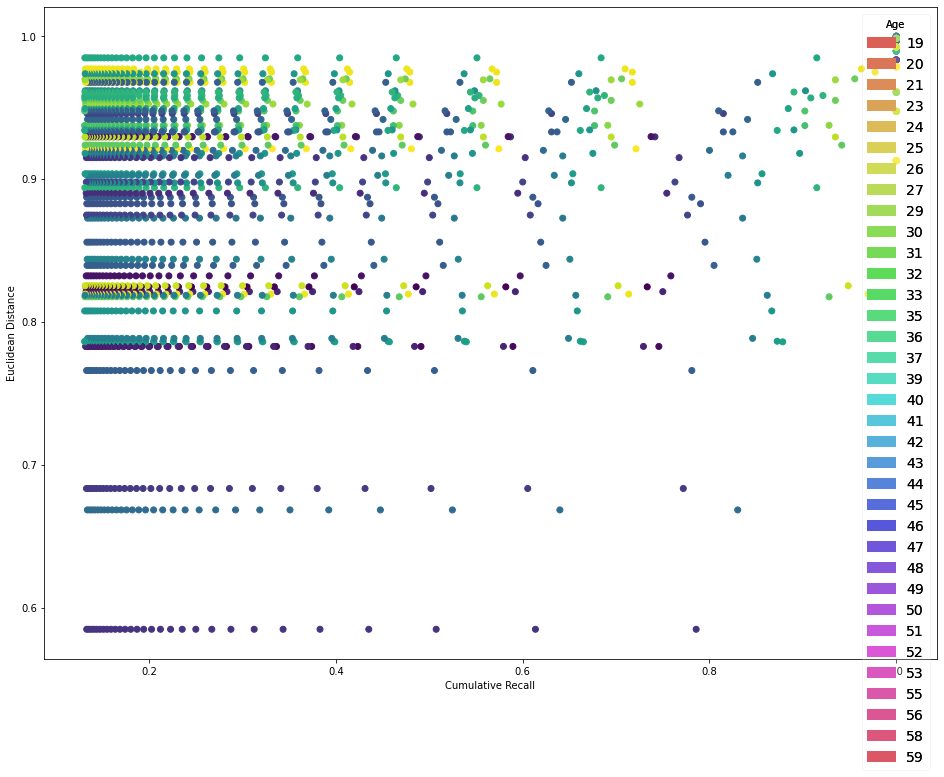

In [52]:
fig, ax = plt.subplots(1,1,figsize=(16,12))
colors = sns.color_palette("hls", len(np.unique(predictions_classes['age'])))
ax.scatter(cumulative_metric['recall'], predictions_classes['cosine'], c=predictions_classes['age'])
# create custom legend, by creating custom lines
custom_lines = [Circle((0,0), 5, color=colors[of]) for of in range(len(np.unique(predictions_classes['age'])))]
# create legend using custom lines
legend1 = ax.legend(custom_lines, np.unique(predictions_classes['age']), loc="upper right", title="Age", framealpha=0.1, fontsize=14)
# add legend to axis
ax.add_artist(legend1)
ax.set_xlabel("Cumulative Recall")
ax.set_ylabel("Euclidean Distance")
fig.show()

## Where and When is the Drift based on TP and FN?

C:\Users\burse\anaconda3\envs\keras_env\lib\site-packages\ipykernel_launcher.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


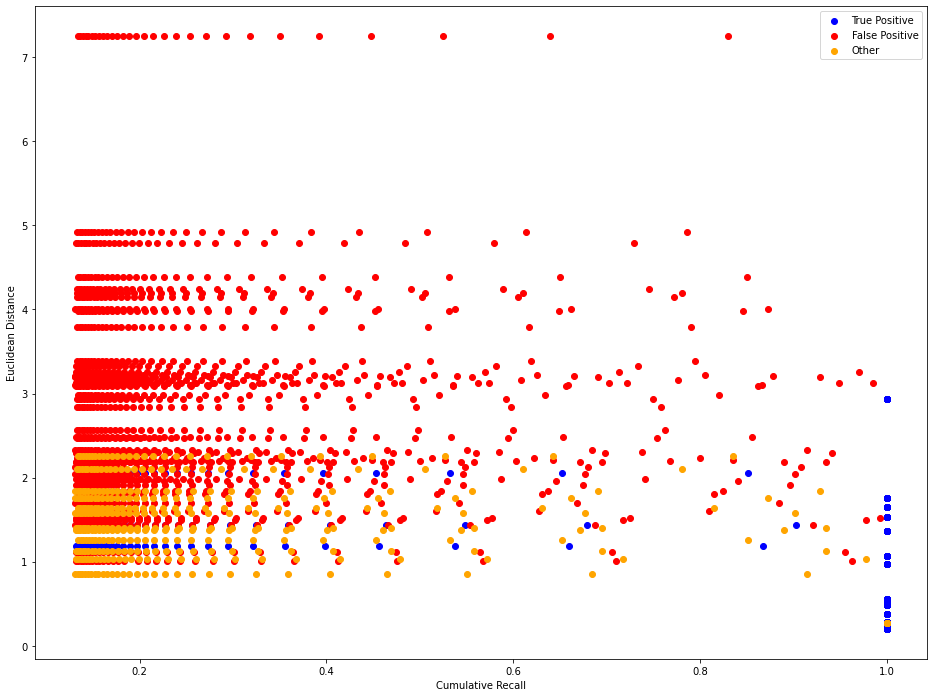

In [51]:
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
import seaborn as sns
import numpy as np

colors = sns.color_palette("hls", len(np.unique(predictions_classes['FN'])))

fig, ax = plt.subplots(1,1,figsize=(16,12))
ax.scatter(cumulative_metric['recall'].loc[predictions_classes['TP'] == 1], predictions_classes['euclidean'].loc[predictions_classes['TP'] == 1], color='blue', label='True Positive')
ax.scatter(cumulative_metric['recall'].loc[predictions_classes['FN'] == 1], predictions_classes['euclidean'].loc[predictions_classes['FN'] == 1], color='red', label='False Positive')
ax.scatter(cumulative_metric['recall'].loc[(predictions_classes['FN'] != 1) & \
                                          (predictions_classes['TP'] != 1)] , predictions_classes['euclidean'].loc[(predictions_classes['FN'] != 1) & \
                                          (predictions_classes['TP'] != 1)], c='orange', label='Other')
plt.legend()
plt.xlabel("Cumulative Recall")
plt.ylabel("Euclidean Distance")
fig.show()

In [15]:
cumulative_metric['accuracy']

0       0.198421
1       0.198421
2       0.198421
3       0.198421
4       0.198421
          ...   
2018    0.198421
2019    0.198421
2020    0.198421
2021    0.198421
2022    0.198421
Name: accuracy, Length: 2023, dtype: float64

In [42]:
pickle.dump(norm_copy, open("drift_synthesis_eda_norm_copy.pkl", "wb"))
pickle.dump(cosine_copy, open("drift_synthesis_eda_cosine_copy.pkl", "wb"))
pickle.dump(stream_sample, open("drift_synthesis_eda_stream_sample.pkl", "wb"))